# CS 117 - Final Project
## 3D Reconstruction of a Mannequin from Images

**name:** Yash Pathak

**SID:** 51317074

### Import relevant libraries

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from camutils import *
from visutils import *
import pickle
import matplotlib.patches as patches
from mpl_toolkits.mplot3d import Axes3D
import glob
import cv2

%matplotlib inline

In [2]:
plt.rcParams['figure.figsize']=[15,15] #adjust this as needed to get clearly visible figures

## Makeroation function for testing camera extrnsic parameters 

In [3]:
def makerotation(rx,ry,rz):
    """
    Generate a rotation matrix    

    Parameters
    ----------
    rx,ry,rz : floats
        Amount to rotate around x, y and z axes in degrees

    Returns
    -------
    R : 2D numpy.array (dtype=float)
        Rotation matrix of shape (3,3)
    """
    # Convert angles from degrees to radians to pass into np.cos and np.sin
    rx_radians = np.radians(rx)
    ry_radians = np.radians(ry)
    rz_radians = np.radians(rz)
    
    # Rotation matrix about the x-axis
    Rx = np.array([
          [1, 0, 0],
          [0, np.cos(rx_radians), -np.sin(rx_radians)],
          [0, np.sin(rx_radians), np.cos(rx_radians)]
          ])
    
    # Rotation matrix about the y-axis
    Ry = np.array([
          [np.cos(ry_radians), 0, np.sin(ry_radians)],
          [0, 1, 0],
          [-np.sin(ry_radians), 0, np.cos(rx_radians)]
          ])
    
    # Rotation matrix about the z-axis
    Rz = np.array([
          [np.cos(rz_radians), -np.sin(rz_radians), 0],
          [np.sin(rz_radians), np.cos(rz_radians), 0],
          [0, 0, 1]
          ])
    
    
    # Combine the rotation matrices:
    R = Rx @ Ry @ Rz
    
    return R 


In [4]:
# Find the calibration images you took (see directions at top of assignment)
# change directory as needed

calibimgfiles = 'calib_jpg_u/*.jpg'
images = glob.glob(calibimgfiles)
print("found ",len(images)," images")

found  40  images


In [5]:
objp = np.zeros((6 * 8,3), np.float32)
objp[:,:2] = 50.625*np.mgrid[0:6, 0:8].T.reshape(-1,2)

## Load and plot the checkerboard patterns

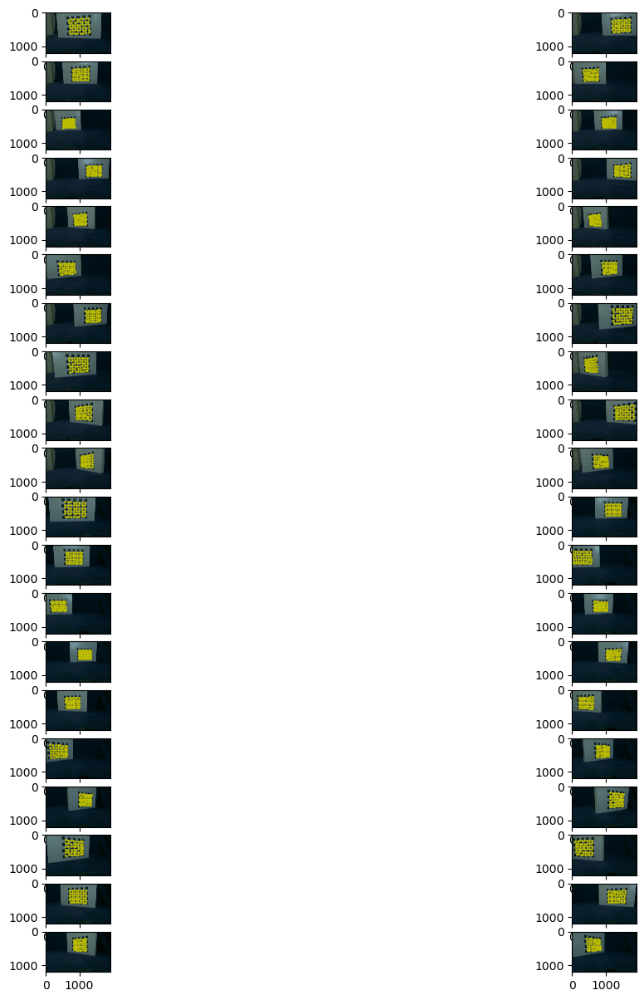

In [6]:
# This section of cod goes through the images and loads each one, uses opencv to find 
# the corners and keeps track of the corners and the "world coordinates" for the grid 
# that we specified above. The collection of these across multiple images gets sent to 
# the intrinsic calibration function.

objpointsL = [] # 3d points in real world space
imgpointsL = [] # 2d points in image plane.

objpointsR = [] # 3d points in real world space
imgpointsR = [] # 2d points in image plane.

# If images are large, it can be quite slow to show 
# them so you might save time turning this off while working
# but please leave it on for the printed version so the images
# are visible
visualize_em = True


if visualize_em:
    fig = plt.figure()
    n_rows = np.ceil(len(images)/2).astype(int)
    
num_images_successfully_processed = 0;
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    img_size = (img.shape[1], img.shape[0])  # note we are assuming all images are the same size
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    in_python_color = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # OpenCV uses BGR, pyplot used RGB
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (6, 8), None) # note the number of squares here
    if ret == True:
        num_images_successfully_processed = num_images_successfully_processed + 1
        if idx < 20:
            objpointsL.append(objp)
            imgpointsL.append(corners)
        else:
            objpointsR.append(objp)
            imgpointsR.append(corners)
        if visualize_em:
            ax = fig.add_subplot(n_rows,2,num_images_successfully_processed)
            plt.imshow(in_python_color)
            plt.scatter(corners[:,0,0],corners[:,0,1],c='y',s=1)

In [7]:
# call the open cv function that gets the intrinsic camera parameters
# note we are assuming all images are the same size

# ret, K, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None) 
retL, KL, distL, rvecsL, tvecsL = cv2.calibrateCamera(objpointsL, imgpointsL, img_size,None,None) 
retR, KR, distR, rvecsR, tvecsR = cv2.calibrateCamera(objpointsR, imgpointsR, img_size, None, None)

# look at the beautiful external parameters K
# Left Camera
print("KL=",KL)
# Right Camera
print("KR=", KR)

KL= [[1.40342239e+03 0.00000000e+00 9.59837031e+02]
 [0.00000000e+00 1.40116582e+03 5.83454863e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
KR= [[1.41025245e+03 0.00000000e+00 9.63549938e+02]
 [0.00000000e+00 1.40794026e+03 5.99720531e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]


## Camera Parameters for calibration

In [8]:
# the camera parameters we will use for 
# our camera calibration work:

my_fL = 0.5 * (KL[0,0]+KL[1,1])
my_cL = KL[0:2,2]
# my_c = np.array([2016, 1512])
# my_f =  2929.7146782467503
# my_c =  np.array([2039.4078, 1495.6169])

print("my_fL = ",my_fL)
print("my_cL = ",my_cL)

# For the right camera:
my_fR = 0.5 * (KR[0,0]+KR[1,1])
my_cR = KR[0:2,2]
# my_c = np.array([2016, 1512])
# my_f =  2929.7146782467503
# my_c =  np.array([2039.4078, 1495.6169])

print("my_fR = ",my_fR)
print("my_cR = ",my_cR)



my_fL =  1402.2941086224503
my_cL =  [959.83703112 583.45486266]
my_fR =  1409.0963508535879
my_cR =  [963.54993841 599.72053134]


In [9]:
camsL = []
cams_pts2L = []

camsR = []
cams_pts2R = []


for idx, fname in enumerate(images):
    img = plt.imread(fname)
    ret, corners = cv2.findChessboardCorners(img, (6,8), None)
    pts2 = corners.squeeze().T
    pts3 = np.zeros((3,6*8))
    xx,yy = np.meshgrid(np.arange(6),np.arange(8))
    pts3[0,:] = 3*yy.reshape(1,-1)
    pts3[1,:] = 3*xx.reshape(1,-1)

    # Now use your calibratePose function to get the extrinsic parameters
    # for the two images. You may need to experiment with the initialization
    # in order to get a good result
    if (idx < 20):
        params_init = np.array([180,0,0,0,0,10])
        cam = Camera(f=my_fL,
                    c=np.array([[my_cL[0],my_cL[1]]]).T,
                    t=np.array([[0,0,0]]).T, 
                    R=makerotation(0,0,0))
        cam = calibratePose(pts3,pts2,cam,params_init)
        camsL.append(cam)
        cams_pts2L.append(pts2)
    else:
        params_init = np.array([180,0,0,0,0,10])
        cam = Camera(f=my_fR,
                    c=np.array([[my_cR[0],my_cR[1]]]).T,
                    t=np.array([[0,0,0]]).T, 
                    R=makerotation(0,0,0))
        cam = calibratePose(pts3,pts2,cam,params_init)
        camsR.append(cam)
        cams_pts2R.append(pts2)

## Visualization for both cameras

The visualization is going to look like there are 20 cameras per visualization with a fixed position for the checkerboard.
However in reality, the checkerboard patterns are moving 20 times for 2 cameras, giving us 40 images to work with and triangulate, figure out and correctly choose any 2 pairs of cameras (C0 and C1) which will help aid the reconstruction of the mesh of the manequin

Legend: Red is for reconstructed!


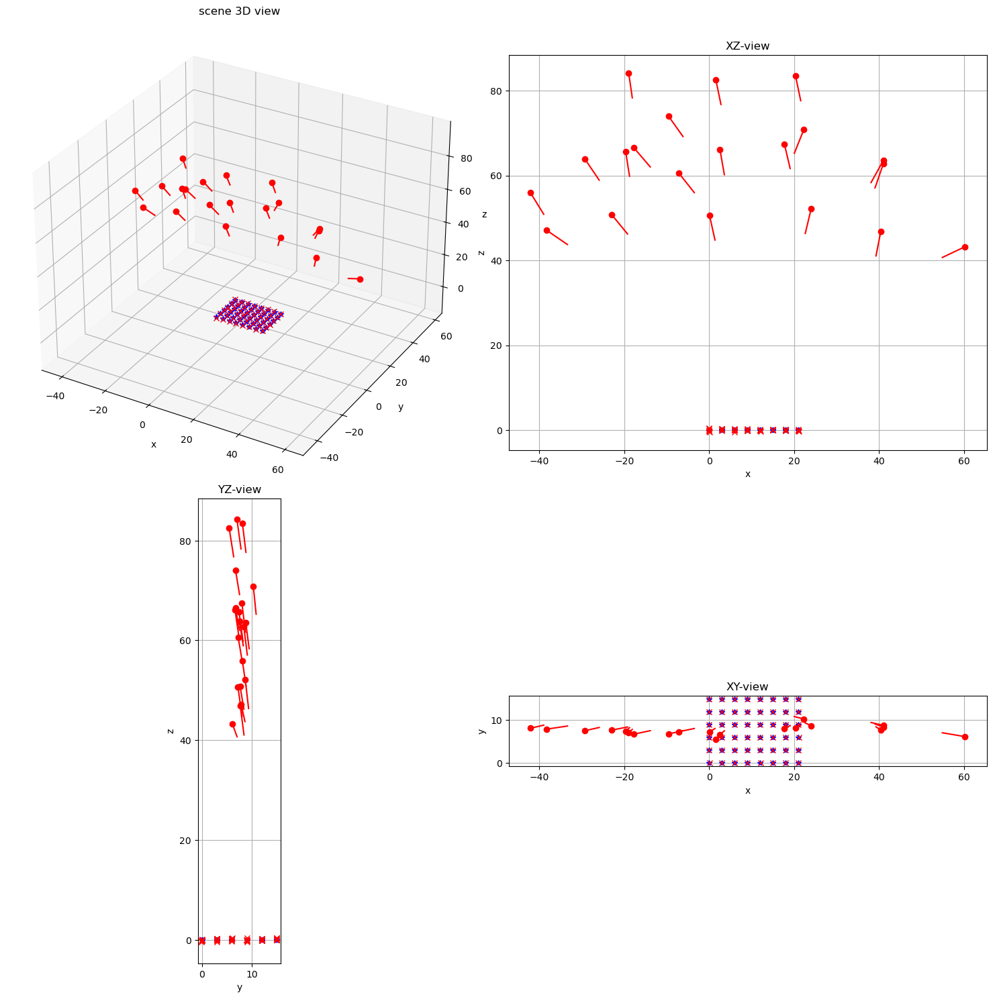

In [10]:
# Now pick two of the cameras/images where you now have the full 
# camera information triangulate the checkerboard points based on the estimated camera pose
# pts3r = triangulate(cams_pts2[0],cams[0],cams_pts2[2],cams[2])

pts3r_L = triangulate(cams_pts2L[0],camsL[0],cams_pts2L[2],camsL[2])

# and visualize all the cameras along with the original points and the version of those you 
# just reconstructed.

visualize_cameras_pts_recovered_pts(camsL,pts3r_L,pts3)

Legend: Red is for reconstructed!


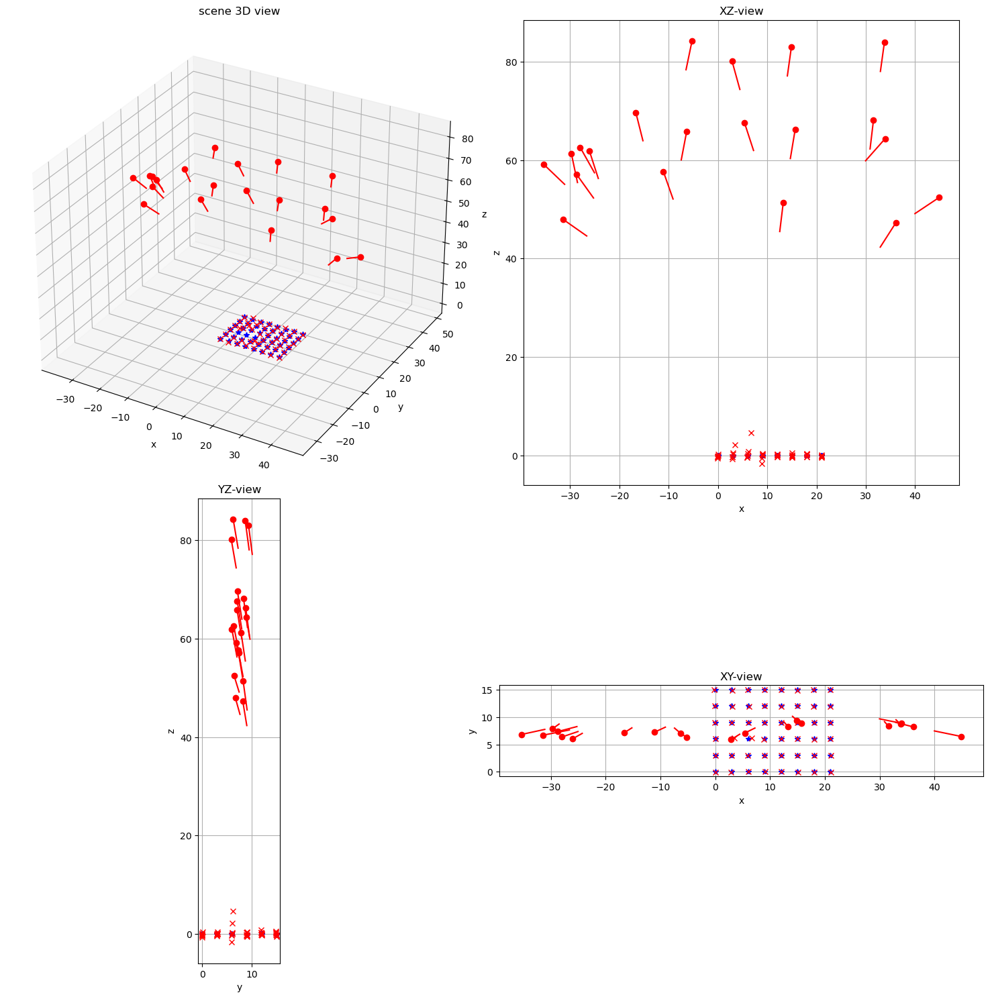

In [11]:
# Now pick two of the cameras/images where you now have the full 
# camera information triangulate the checkerboard points based on the estimated camera pose
# pts3r = triangulate(cams_pts2[0],cams[0],cams_pts2[2],cams[2])

pts3r_R = triangulate(cams_pts2R[0],camsR[0],cams_pts2R[2],camsR[2])

# and visualize all the cameras along with the original points and the version of those you 
# just reconstructed.

visualize_cameras_pts_recovered_pts(camsR,pts3r_R,pts3)

## Decode function

In [12]:
def decode(imprefix,start,threshold):
    """
    Given a sequence of 20 images of a scene showing projected 10 bit gray code, 
    decode the binary sequence into a decimal value in (0,1023) for each pixel.
    Mark those pixels whose code is likely to be incorrect based on the user 
    provided threshold.  Images are assumed to be named "imageprefixN.png" where
    N is a 2 digit index (e.g., "img00.png,img01.png,img02.png...")
 
    Parameters
    ----------
    imprefix : str
       Image name prefix
      
    start : int
       Starting index
       
    threshold : float
       Threshold to determine if a bit is decodeable
       
    Returns
    -------
    code : 2D numpy.array (dtype=float)
        Array the same size as input images with entries in (0..1023)
        
    mask : 2D numpy.array (dtype=logical)
        Array indicating which pixels were correctly decoded based on the threshold
    
    """
    
    # we will assume a 10 bit code
    nbits = 10
    
    # don't forget to convert images to grayscale / float after loading them in
    # Lists to store binary bits and masks
    bit_stack = []
    masks = []
    
    
    # create some synthetic test cases here by just creating an array I
    # with random values in it and see that it passes the test above
    def grayscale_converter(image):
        # convert to float data type and scale to [0..1] if necessary
        image.astype(np.float32) / 255.0
        # If your image has an alpha channel (HxWx4) you should just drop the alpha channel.
        if image.shape[-1] == 4:
            image = image[:, :, :3]
            
        # grayscale the image, and add another dimension (containing 1 color chanel as depth, the grayscale color)
        if image.shape[-1] == 3:
            image = np.mean(image, axis = 2)
        return image
    
    
    # Iterate through the 10 pairs of images
    for i in range(nbits):
        # print((f"{imprefix}\gray\{start + 2 * i:02d}.png"))
        # Load the images
        img1 = plt.imread(f"{imprefix}{start + 2 * i:02d}.png")
        img2 = plt.imread(f"{imprefix}{start + 2 * i + 1:02d}.png")
        
        # Now, convert these ijmages to grayscale
        img1 = grayscale_converter(img1)
        img2 = grayscale_converter(img2)
        
                
        # Calculate the bit value for this pair comparing first image to second image
        bit = img1 >= img2
        
        # Generate the mask for this bit (reliable pixels)
        mask = np.abs(img1 - img2) > threshold
        
        # Append to the stacks
        bit_stack.append(bit)
        masks.append(mask)
    
    # Combine masks for all bits (only pixels with all bits reliable are valid)
    mask = np.logical_and.reduce(masks)

    # Convert bit stack from gray code to binary
    gray_code = np.array(bit_stack, dtype=np.uint8)
    binary_code = np.zeros_like(gray_code)
    binary_code[0] = gray_code[0]
    
    # Leaving out MSB, we start at index 1
    for i in range(1, nbits):
        binary_code[i] = binary_code[i - 1] ^ gray_code[i]
    
    # Convert binary code to decimal
    code = np.sum(binary_code * (2 ** np.arange(nbits)[::-1, None, None]), axis=0)
    
    # Mask invalid pixels
    code[~mask] = 0
 
        
    return code,mask

# Visualization Manny 0

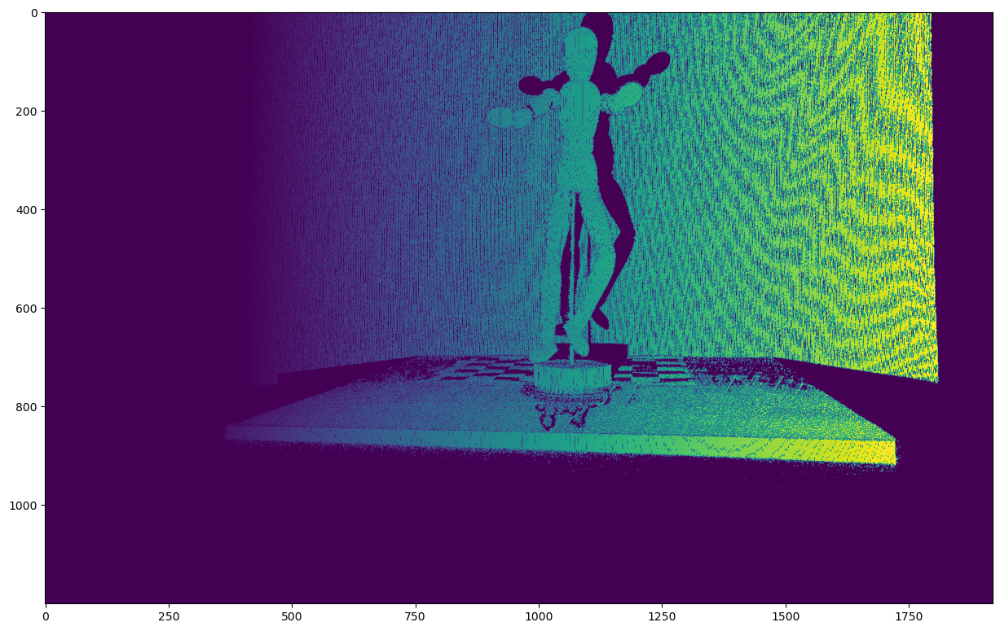

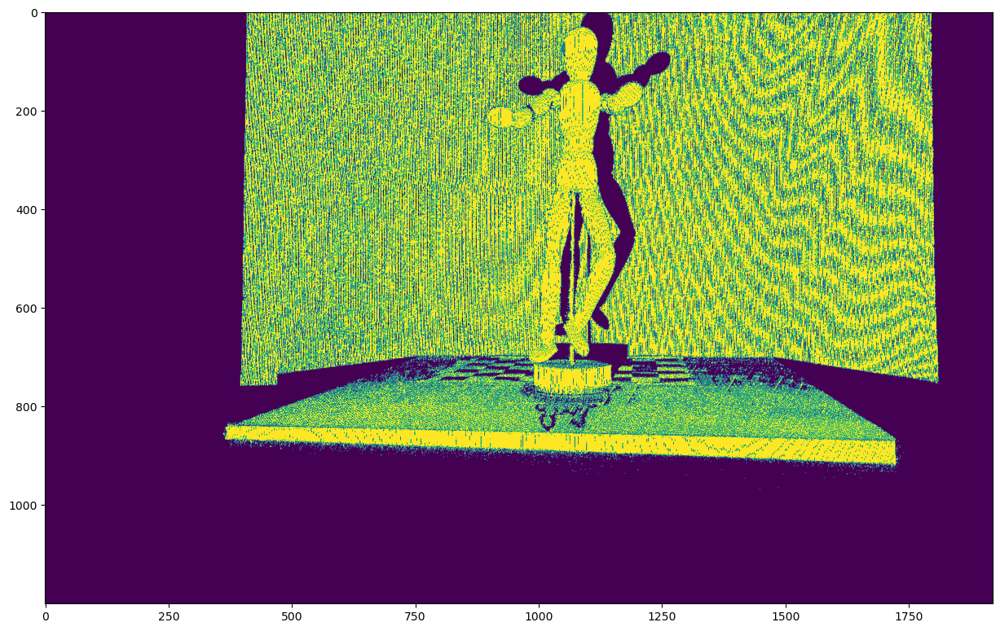

In [13]:
#
# Visualize results for the first scan and experiment to determine a good threshold
#
threshold = 0.01
code,mask = decode('manny\grab_0_u\\frame_C0_',0,threshold)

# display view code and mask as images

plt.rcParams['figure.figsize']=[15,15] #adjust this as needed to get clearly visible figures
plt.imshow(code, plt.show())
plt.imshow(mask, plt.show())



## Reconstruct function

Added a clean point cloud formation that will be used to ensure cleaning up of the 3d reconstruction of the image.

In [14]:
def reconstruct(imprefixL,imprefixR,threshold,camL,camR):
    """
    Performing matching and triangulation of points on the surface using structured
    illumination. This function decodes the binary graycode patterns, matches 
    pixels with corresponding codes, and triangulates the result.
    
    The returned arrays include 2D and 3D coordinates of only those pixels which
    were triangulated where pts3[:,i] is the 3D coordinte produced by triangulating
    pts2L[:,i] and pts2R[:,i]

    Parameters
    ----------
    imprefixL, imprefixR : str
        Image prefixes for the coded images from the left and right camera
        
    threshold : float
        Threshold to determine if a bit is decodeable
   
    camL,camR : Camera
        Calibration info for the left and right cameras
        
    Returns
    -------
    pts2L,pts2R : 2D numpy.array (dtype=float)
        The 2D pixel coordinates of the matched pixels in the left and right
        image stored in arrays of shape 2xN
        
    pts3 : 2D numpy.array (dtype=float)
        Triangulated 3D coordinates stored in an array of shape 3xN
        
    """

    # Decode the H and V coordinates for the two views
    V_left, maskV_left = decode(imprefixL, start=0, threshold=threshold)
    H_left, maskH_left = decode(imprefixL, start=20, threshold=threshold)
    V_right, maskV_right = decode(imprefixR, start=0, threshold=threshold)
    H_right, maskH_right = decode(imprefixR, start=20, threshold=threshold)

    # Construct the combined 20 bit code C = H + 1024*V and mask for each view
    C_left = H_left + (1024*V_left)
    mask_left = maskH_left & maskV_left
    C_right = H_right + (1024*V_right)
    mask_right = maskH_right & maskV_right
    
    # Find the indices of pixels in the left and right code image that 
    # have matching codes. If there are multiple matches, just
    # choose one arbitrarily.
    C_left_flat = C_left.flatten()
    C_right_flat = C_right.flatten()
    mask_left_flat = mask_left.flatten()
    mask_right_flat = mask_right.flatten()
    
    valid_left = C_left_flat[mask_left_flat]
    valid_right = C_right_flat[mask_right_flat]
    
    matched, matchL, matchR = np.intersect1d(valid_left, valid_right, return_indices=True)
    
    # Let CL and CR be the flattened arrays of codes for the left and right view
    # Suppose you have computed arrays of indices matchL and matchR so that 
    # CL[matchL[i]] == CR[matchR[i]] for all i.  The code below gives one approach
    # to generating the corresponding pixel coordinates for the matched pixels.
    h, w = C_left.shape

    xx,yy = np.meshgrid(range(w),range(h))
    xx = np.reshape(xx,(-1,1))
    yy = np.reshape(yy,(-1,1))
    pts2L = np.concatenate((xx[mask_left_flat][matchL].T, yy[mask_left_flat][matchL].T), axis=0)
    pts2R = np.concatenate((xx[mask_right_flat][matchR].T, yy[mask_right_flat][matchR].T), axis=0)

    
    
    # Now triangulate the points
    pts3 = triangulate(pts2L, camL, pts2R, camR)
    
    return pts2L,pts2R,pts3

## Specifying 2 cameras here

In [15]:
# Pick any of the positions of the 2 cameras from the two lists of cameras as our 0th and 1st camera for reconsturction
camC0 = camsL[10]
camC1 = camsR[10]

## Visualize Reconstruction of points/manny function

In [16]:
# Add your visualization code here.  As we have done previously it is good to visualize different
# 2D projections XY, XZ, YZ and well as a 3D version
def visualize_reconstruction(pts3, camL, camR, looklength=20):
    """
    Visualize the 3D reconstruction and its 2D projections.

    Parameters
    ----------
    pts3 : 2D numpy.array (dtype=float) of shape (3,N)
        Triangulated 3D points.
    camL, camR : Camera
        Calibration data for left and right cameras.
    looklength : float, optional
        Length of the look vector, default is 20.
    """
    # Camera view vectors
    lookL = np.hstack((camL.t, camL.t + camL.R @ np.array([[0, 0, looklength]]).T))
    lookR = np.hstack((camR.t, camR.t + camR.R @ np.array([[0, 0, looklength]]).T))

    # 3D Plot
    fig = plt.figure(figsize=(12, 10))

    ax3d = fig.add_subplot(2, 2, 1, projection='3d')
    ax3d.scatter(pts3[0, :], pts3[1, :], pts3[2, :], s=1, c='b', label='3D Points')
    ax3d.plot(camL.t[0], camL.t[1], camL.t[2], 'ro', label='Camera Left')
    ax3d.plot(camR.t[0], camR.t[1], camR.t[2], 'go', label='Camera Right')
    ax3d.plot(lookL[0, :], lookL[1, :], lookL[2, :], 'r', label='Look Vector Left')
    ax3d.plot(lookR[0, :], lookR[1, :], lookR[2, :], 'g', label='Look Vector Right')

    # Set axis limits
    ax3d.set_xlim([-500, 400])
    ax3d.set_ylim([-500, 300])
    ax3d.set_zlim([-500, 200])
    ax3d.set_xlabel('X')
    ax3d.set_ylabel('Y')
    ax3d.set_zlabel('Z')
    ax3d.legend()
    ax3d.set_title('3D View of Reconstructed Scene')

    # 2D XZ Projection
    axXZ = fig.add_subplot(2, 2, 2)
    axXZ.scatter(pts3[0, :], pts3[2, :], s=1, c='b')
    axXZ.plot(lookL[0, :], lookL[2, :], 'r')
    axXZ.plot(lookR[0, :], lookR[2, :], 'g')
    axXZ.set_xlim([-200, 400])
    axXZ.set_ylim([-500, 200])
    axXZ.set_xlabel('X')
    axXZ.set_ylabel('Z')
    axXZ.set_title('XZ Projection')
    axXZ.grid()

    # 2D YZ Projection
    axYZ = fig.add_subplot(2, 2, 3)
    axYZ.scatter(pts3[1, :], pts3[2, :], s=1, c='b')
    axYZ.plot(lookL[1, :], lookL[2, :], 'r')
    axYZ.plot(lookR[1, :], lookR[2, :], 'g')
    axYZ.set_xlim([-150, 250])
    axYZ.set_ylim([-500, 200])
    axYZ.set_xlabel('Y')
    axYZ.set_ylabel('Z')
    axYZ.set_title('YZ Projection')
    axYZ.grid()

    # 2D XY Projection
    axXY = fig.add_subplot(2, 2, 4)
    axXY.scatter(pts3[0, :], pts3[1, :], s=1, c='b')
    axXY.plot(lookL[0, :], lookL[1, :], 'r')
    axXY.plot(lookR[0, :], lookR[1, :], 'g')
    axXY.set_xlim([-200, 400])
    axXY.set_ylim([250, -150])
    axXY.set_xlabel('X')
    axXY.set_ylabel('Y')
    axXY.set_title('XY Projection')
    axXY.grid()

    plt.tight_layout()
    plt.show()


# Manny 0 reconstruction

Cam C0 Intrinsic and Extrinsic Parameters:
 Camera : 
 f=1402.2941086224503 
 c=[[959.83703112 583.45486266]] 
 R=[[-0.92568991  0.07930332 -0.36987725]
 [ 0.0476015   0.99442624  0.09407735]
 [ 0.37527629  0.06947974 -0.92430529]] 
 t = [[22.27929377 10.29743094 70.77962746]]
Cam C1 Intrinsic and Extrinsic Parameters:
 Camera : 
 f=1409.0963508535879 
 c=[[963.54993841 599.72053134]] 
 R=[[-0.7486333   0.09233555 -0.65652291]
 [ 0.00551394  0.99108698  0.1331022 ]
 [ 0.66296137  0.09602471 -0.74246985]] 
 t = [[33.89473112  8.8779164  64.3232447 ]]


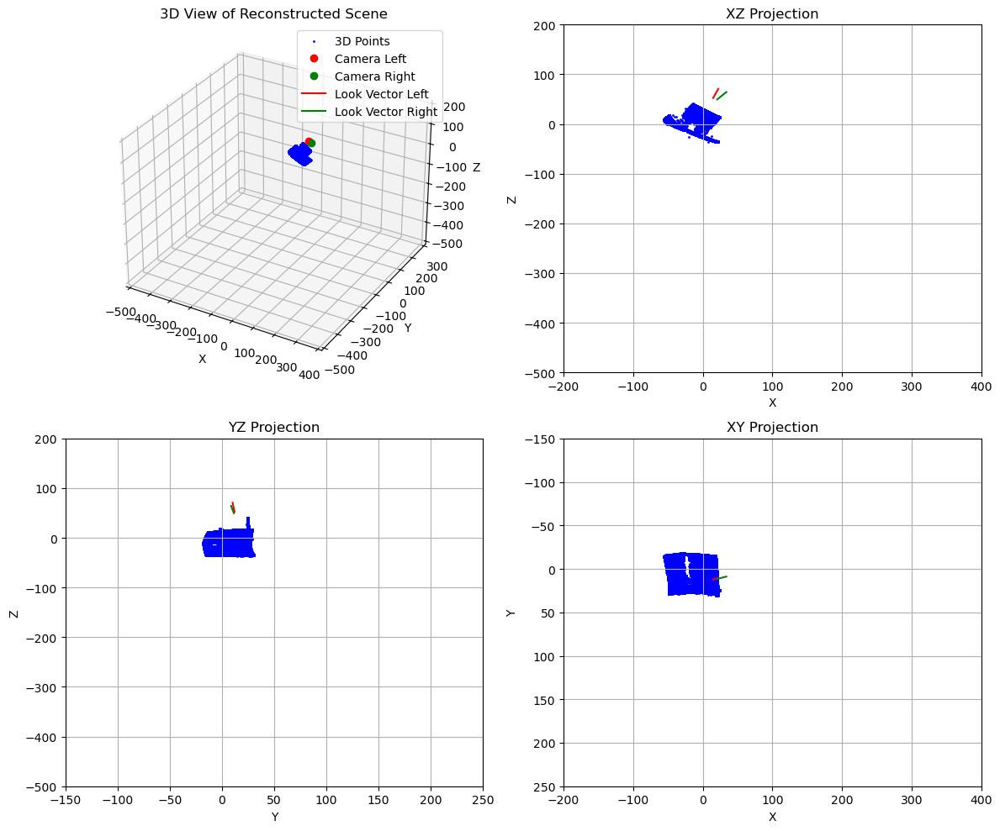

In [17]:
#
# Reconstruct and visualize the results
#
# 

# Image prefixes for the left and right cameras
# C0 is to the right relatively
imprefixC0 = "manny\grab_0_u\\frame_C0_"
# C1 is to the left relatively
imprefixC1 = "manny\grab_0_u\\frame_C1_"
# Default threshold value for now
threshold = 0.01

print("Cam C0 Intrinsic and Extrinsic Parameters:\n", camC0)
print("Cam C1 Intrinsic and Extrinsic Parameters:\n", camC1)

pts2L_manny0,pts2R_manny0,pts3_manny0 = reconstruct(imprefixC0,imprefixC1,threshold,camC0,camC1)

# Example usage
# pts3: Triangulated 3D points (3xN numpy array)
# camL and camR: Left and Right camera calibration data
plt.rcParams['figure.figsize']=[15,15] #adjust this as needed to get clearly visible figures

visualize_reconstruction(pts3_manny0, camC0, camC1)

## Triangle Meshing and Pruning Function

In [18]:
# Mesh cleanup parameters
from scipy.spatial import Delaunay
import matplotlib.pyplot as plt


def triangle_meshing_pruning(pts2L, pts3):
    # Specify limits along the x,y and z axis of a box containing the object
    # we will prune out triangulated points outside these limits
     
    boxlimits = np.array([-20, 20, -23.75, 23.9, -12, 20]) # Bounding box should be [xmin, xmax, ymin, ymax, zmin, zmax]
    # boxlimits = np.array([-200,400,-150, 200, -400,200]) # Bounding box should be [xmin, xmax, ymin, ymax, zmin, zmax]

    # Specify a longest allowed edge that can appear in the mesh. Remove triangles
    # from the final mesh that have edges longer than this value
    trithresh = 2 # max allowed test in mm
    

    #
    # bounding box pruning
    #

    in_box = np.where(
        (pts3[0, :] >= boxlimits[0]) & (pts3[0, :] <= boxlimits[1]) & # horizontal pov
        (pts3[1, :] >= boxlimits[2]) & (pts3[1, :] <= boxlimits[3]) & # vertical top to bottom
        (pts3[2, :] >= boxlimits[4]) & (pts3[2, :] <= boxlimits[5]) # depth POV front and back
    )[0]

    pts3_boxed = pts3[:, in_box]
    pts2L_boxed = pts2L[:, in_box]


    #
    # triangulate the 2D points to get the surface mesh
    #
    # using Delaunay, triangulate the 2d points
    tri = Delaunay(pts2L_boxed.T)
    triangles = tri.simplices


    #
    # triangle pruning
    #

    valid_triangles = []
    for t in triangles:
        v0, v1, v2 = pts3_boxed[:, t[0]], pts3_boxed[:, t[1]], pts3_boxed[:, t[2]]
        edges = [
            np.linalg.norm(v1 - v0),
            np.linalg.norm(v2 - v1),
            np.linalg.norm(v0 - v2)
        ]
        if max(edges) <= trithresh:
            valid_triangles.append(t)

    valid_triangles = np.array(valid_triangles)

    #
    # remove any points which are not refenced in any triangle
    #
    unique_indices = np.unique(valid_triangles)
    print(len(unique_indices))
            
    idx_map = {old_idx: new_idx for new_idx, old_idx in enumerate(unique_indices)}

    # Map valid triangles to new indices
    pruned_faces = np.array([[idx_map[idx] for idx in face] for face in valid_triangles])

    # Extract pruned 3D points
    pruned_pts3 = pts3_boxed[:, unique_indices]
    
    # Sample colors from the image
    # vertex_colors = []
    # for i in unique_indices:
    #     u, v = int(pts2L[0, i]), int(pts2L[1, i])  # Pixel coordinates
    #     color = imageL[v, u]  # Get RGB color
    #     vertex_colors.append(color)
    # vertex_colors = np.array(vertex_colors) / 255.0  # Normalize to [0, 1]
    
    return pruned_pts3, pruned_faces 



In [19]:
image = f"final-project\manny\\grab_0_u\\color_C0_01.png"

pruned_pts3_manny0, pruned_faces_manny0 = triangle_meshing_pruning(pts2L_manny0, pts3_manny0)

27496


In [20]:
# vis code goes here
import trimesh

#
# An alternative is to use the trimesh library (https://github.com/mikedh/trimesh)
# you will need to install it via. "pip install trimesh"
# A nice feature is that it will create a plot which is interactive (so you can
# drag with the mouse pointer to rotate the 3D mesh to view from different directions)
#
mesh_manny0 = trimesh.Trimesh(vertices=pruned_pts3_manny0.T,faces=pruned_faces_manny0[:,[0,2,1]])
mesh_manny0.show()

# Now work at different orientations of the manequin

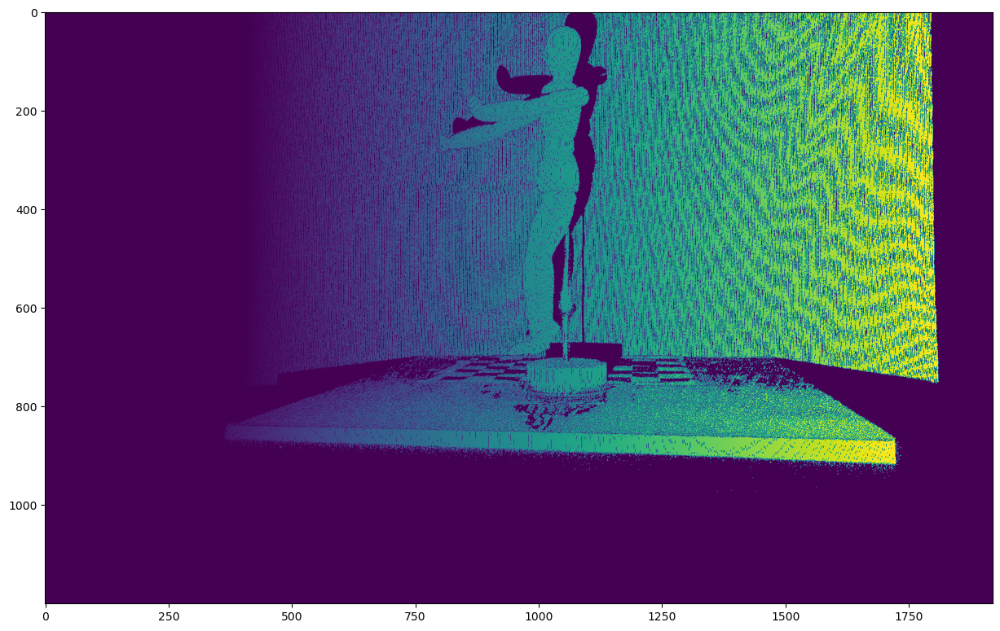

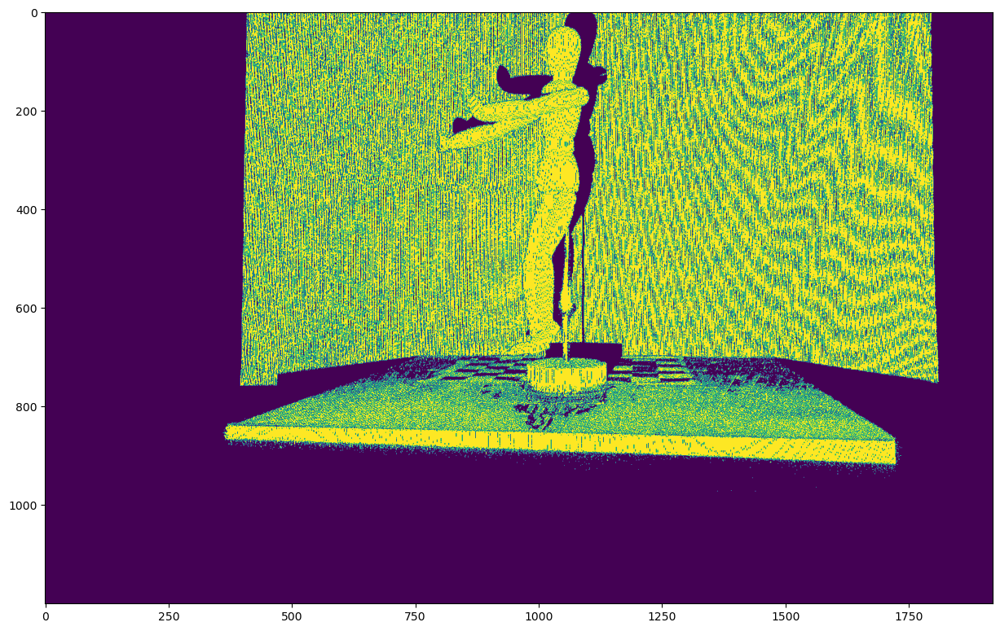

In [21]:
#
# Visualize results for the first scan and experiment to determine a good threshold
#
threshold = 0.01
code,mask = decode('manny\grab_1_u\\frame_C0_',0,threshold)

# display view code and mask as images

plt.rcParams['figure.figsize']=[15,15] #adjust this as needed to get clearly visible figures
plt.imshow(code, plt.show())
plt.imshow(mask, plt.show())

# plt.figure(figsize=(10, 5))
# plt.subplot(1, 2, 1)
# plt.title("Decoded Code")
# plt.imshow(code, cmap="viridis")
# plt.colorbar()

# plt.subplot(1, 2, 2)
# plt.title("Mask")
# plt.imshow(mask, cmap="gray")
# plt.colorbar()

# plt.show()


Cam C0 Intrinsic and Extrinsic Parameters:
 Camera : 
 f=1402.2941086224503 
 c=[[959.83703112 583.45486266]] 
 R=[[-0.92568991  0.07930332 -0.36987725]
 [ 0.0476015   0.99442624  0.09407735]
 [ 0.37527629  0.06947974 -0.92430529]] 
 t = [[22.27929377 10.29743094 70.77962746]]
Cam C1 Intrinsic and Extrinsic Parameters:
 Camera : 
 f=1409.0963508535879 
 c=[[963.54993841 599.72053134]] 
 R=[[-0.7486333   0.09233555 -0.65652291]
 [ 0.00551394  0.99108698  0.1331022 ]
 [ 0.66296137  0.09602471 -0.74246985]] 
 t = [[33.89473112  8.8779164  64.3232447 ]]


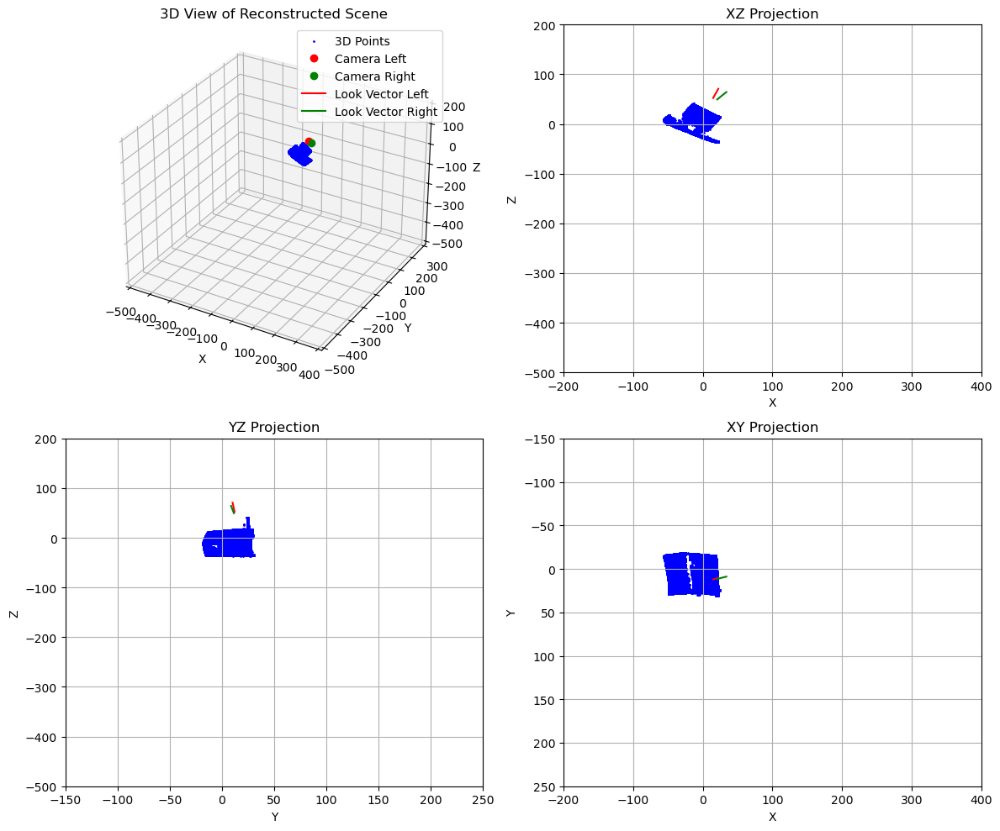

In [22]:
#
# Reconstruct and visualize the results
#
# 

# Image prefixes for the left and right cameras
# C0 is to the right relatively
imprefixC0 = "manny\grab_1_u\\frame_C0_"
# C1 is to the left relatively
imprefixC1 = "manny\grab_1_u\\frame_C1_"
# Default threshold value for now
threshold = 0.01

print("Cam C0 Intrinsic and Extrinsic Parameters:\n", camC0)
print("Cam C1 Intrinsic and Extrinsic Parameters:\n", camC1)

pts2L_manny1,pts2R_manny1,pts3_manny1 = reconstruct(imprefixC0,imprefixC1,threshold,camC0,camC1)

plt.rcParams['figure.figsize']=[15,15] #adjust this as needed to get clearly visible figures
# visutils_2.vis_scene(camC0,camC1,pts3,looklength=20)

# Example usage
# pts3: Triangulated 3D points (3xN numpy array)
# camL and camR: Left and Right camera calibration data
visualize_reconstruction(pts3_manny1, camC0, camC1)



In [23]:
pruned_pts3_manny1, pruned_faces_manny1 = triangle_meshing_pruning(pts2L_manny1, pts3_manny1)

27319


In [24]:
mesh_manny1 = trimesh.Trimesh(vertices=pruned_pts3_manny1.T,faces=pruned_faces_manny1[:,[0,2,1]])
mesh_manny1.show()

# Manny 2

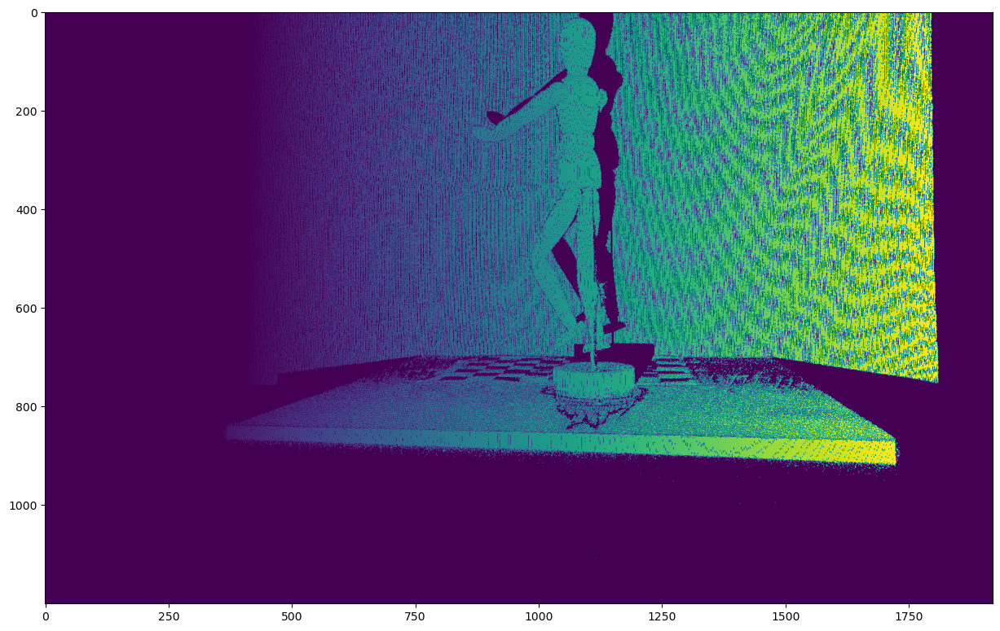

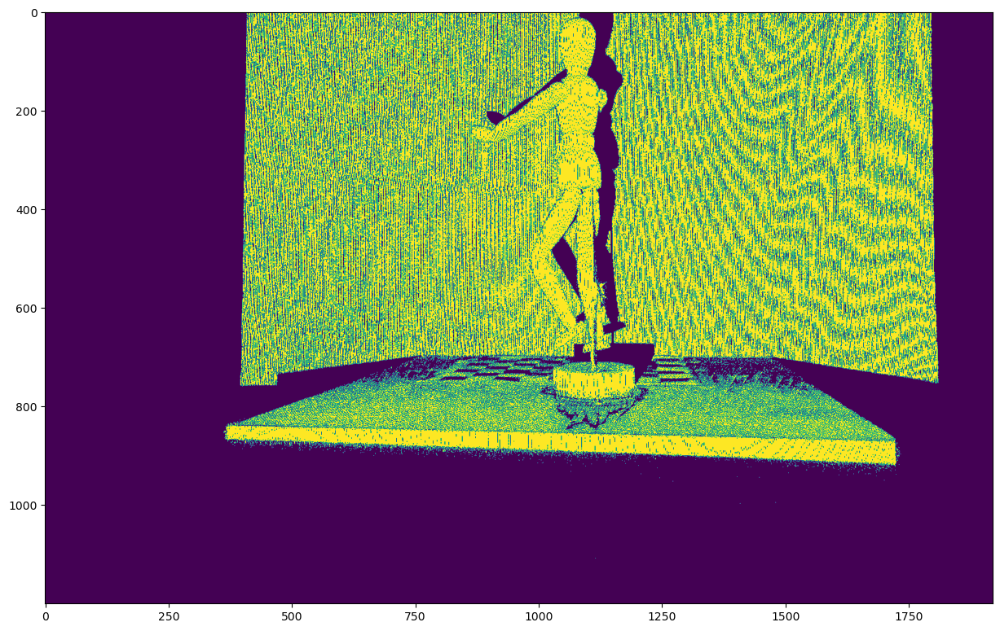

In [25]:
#
# Visualize results for the first scan and experiment to determine a good threshold
#
threshold = 0.01
code,mask = decode('manny\grab_2_u\\frame_C0_',0,threshold)

# display view code and mask as images

plt.rcParams['figure.figsize']=[15,15] #adjust this as needed to get clearly visible figures
plt.imshow(code, plt.show())
plt.imshow(mask, plt.show())

# plt.figure(figsize=(10, 5))

Cam C0 Intrinsic and Extrinsic Parameters:
 Camera : 
 f=1402.2941086224503 
 c=[[959.83703112 583.45486266]] 
 R=[[-0.92568991  0.07930332 -0.36987725]
 [ 0.0476015   0.99442624  0.09407735]
 [ 0.37527629  0.06947974 -0.92430529]] 
 t = [[22.27929377 10.29743094 70.77962746]]
Cam C1 Intrinsic and Extrinsic Parameters:
 Camera : 
 f=1409.0963508535879 
 c=[[963.54993841 599.72053134]] 
 R=[[-0.7486333   0.09233555 -0.65652291]
 [ 0.00551394  0.99108698  0.1331022 ]
 [ 0.66296137  0.09602471 -0.74246985]] 
 t = [[33.89473112  8.8779164  64.3232447 ]]


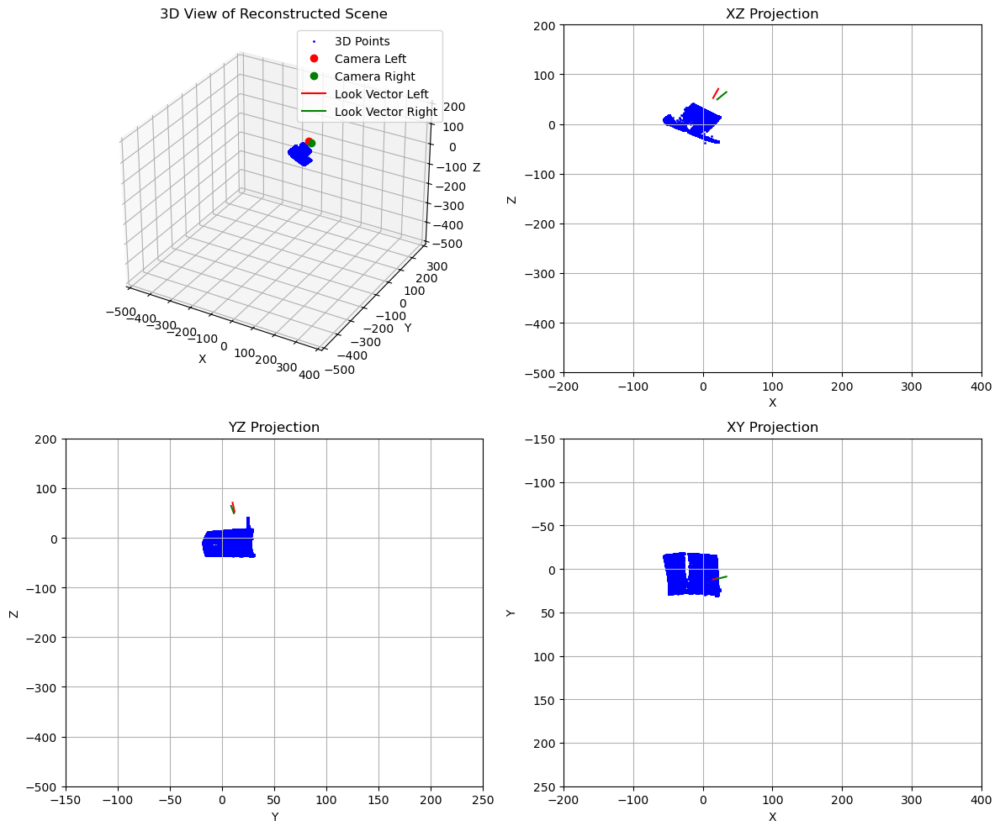

In [26]:
#
# Reconstruct and visualize the results
#
# 

# Image prefixes for the left and right cameras
# C0 is to the right relatively
imprefixC0 = "manny\grab_2_u\\frame_C0_"
# C1 is to the left relatively
imprefixC1 = "manny\grab_2_u\\frame_C1_"
# Default threshold value for now
threshold = 0.01

print("Cam C0 Intrinsic and Extrinsic Parameters:\n", camC0)
print("Cam C1 Intrinsic and Extrinsic Parameters:\n", camC1)

pts2L_manny2,pts2R_manny2,pts3_manny2 = reconstruct(imprefixC0,imprefixC1,threshold,camC0,camC1)

plt.rcParams['figure.figsize']=[15,15] #adjust this as needed to get clearly visible figures
# visutils_2.vis_scene(camC0,camC1,pts3,looklength=20)

# Example usage
# pts3: Triangulated 3D points (3xN numpy array)
# camL and camR: Left and Right camera calibration data
visualize_reconstruction(pts3_manny2, camC0, camC1)



In [27]:
pruned_pts3_manny2, pruned_faces_manny2 = triangle_meshing_pruning(pts2L_manny2, pts3_manny2)

27126


In [28]:
mesh_manny2 = trimesh.Trimesh(vertices=pruned_pts3_manny2.T,faces=pruned_faces_manny2[:,[0,2,1]])
mesh_manny2.show()

# Manny 3

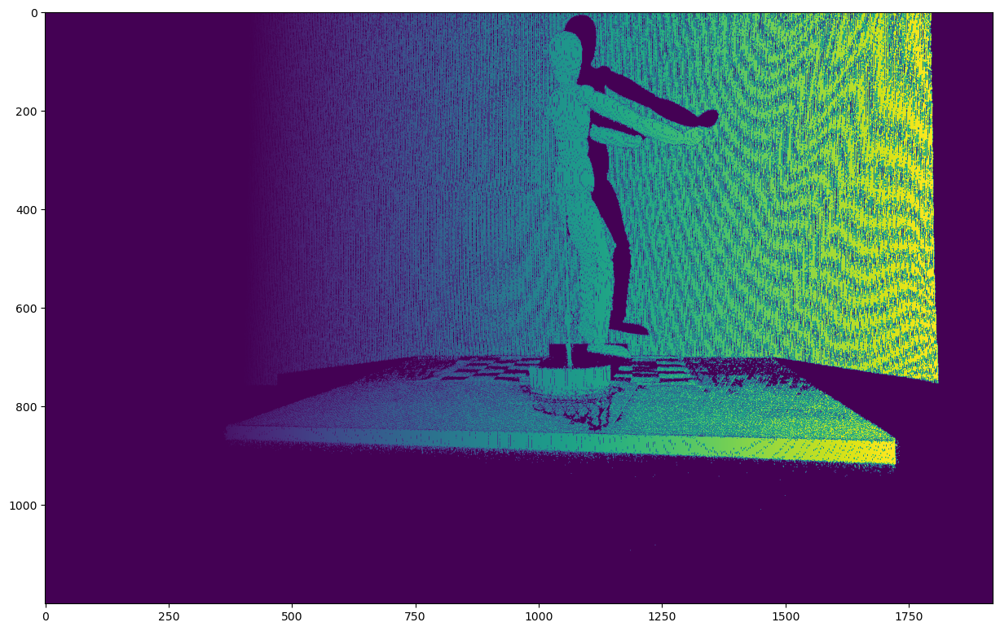

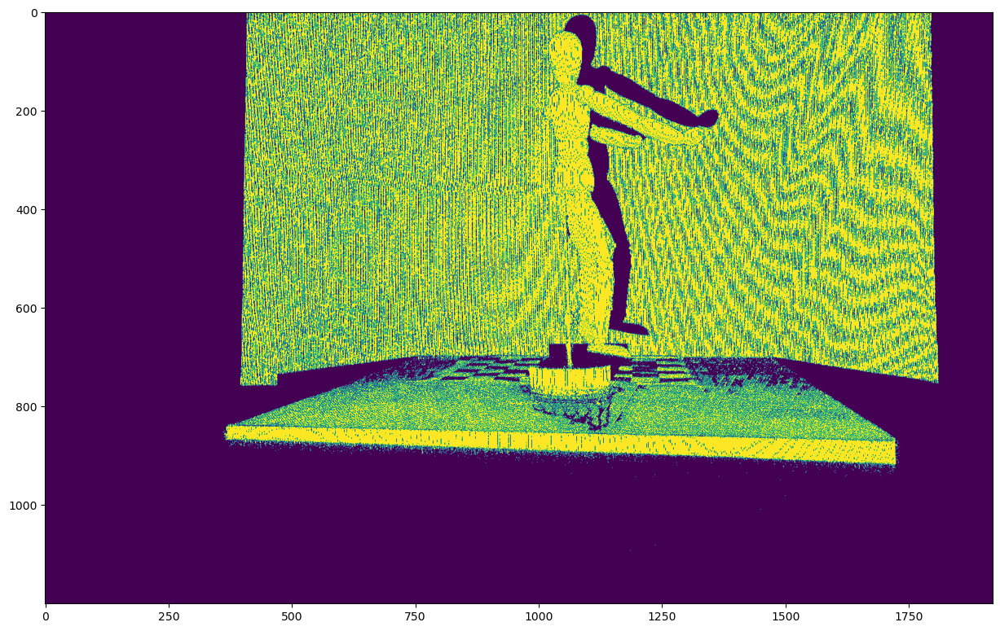

In [29]:
#
# Visualize results for the first scan and experiment to determine a good threshold
#
threshold = 0.01
code,mask = decode('manny\grab_3_u\\frame_C0_',0,threshold)

# display view code and mask as images

plt.rcParams['figure.figsize']=[15,15] #adjust this as needed to get clearly visible figures
plt.imshow(code, plt.show())
plt.imshow(mask, plt.show())

# plt.figure(figsize=(10, 5))

Cam C0 Intrinsic and Extrinsic Parameters:
 Camera : 
 f=1402.2941086224503 
 c=[[959.83703112 583.45486266]] 
 R=[[-0.92568991  0.07930332 -0.36987725]
 [ 0.0476015   0.99442624  0.09407735]
 [ 0.37527629  0.06947974 -0.92430529]] 
 t = [[22.27929377 10.29743094 70.77962746]]
Cam C1 Intrinsic and Extrinsic Parameters:
 Camera : 
 f=1409.0963508535879 
 c=[[963.54993841 599.72053134]] 
 R=[[-0.7486333   0.09233555 -0.65652291]
 [ 0.00551394  0.99108698  0.1331022 ]
 [ 0.66296137  0.09602471 -0.74246985]] 
 t = [[33.89473112  8.8779164  64.3232447 ]]


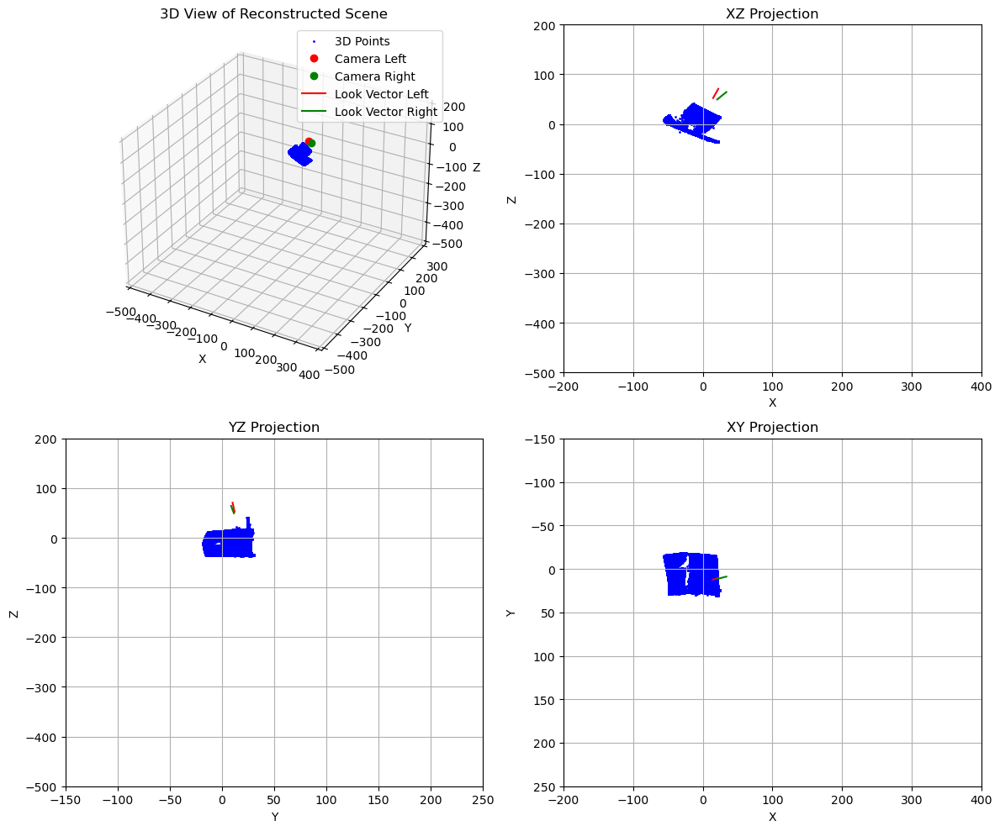

In [30]:
#
# Reconstruct and visualize the results
#
# 

# Image prefixes for the left and right cameras
# C0 is to the right relatively
imprefixC0 = "manny\grab_3_u\\frame_C0_"
# C1 is to the left relatively
imprefixC1 = "manny\grab_3_u\\frame_C1_"
# Default threshold value for now
threshold = 0.01

print("Cam C0 Intrinsic and Extrinsic Parameters:\n", camC0)
print("Cam C1 Intrinsic and Extrinsic Parameters:\n", camC1)

pts2L_manny3,pts2R_manny3,pts3_manny3 = reconstruct(imprefixC0,imprefixC1,threshold,camC0,camC1)

plt.rcParams['figure.figsize']=[15,15] #adjust this as needed to get clearly visible figures
# visutils_2.vis_scene(camC0,camC1,pts3,looklength=20)

# Example usage
# pts3: Triangulated 3D points (3xN numpy array)
# camL and camR: Left and Right camera calibration data
visualize_reconstruction(pts3_manny3, camC0, camC1)



In [31]:
pruned_pts3_manny3, pruned_faces_manny3 = triangle_meshing_pruning(pts2L_manny3, pts3_manny3)

26572


In [32]:
mesh_manny3 = trimesh.Trimesh(vertices=pruned_pts3_manny3.T,faces=pruned_faces_manny3[:,[0,2,1]])
mesh_manny3.show()

# Manny 4

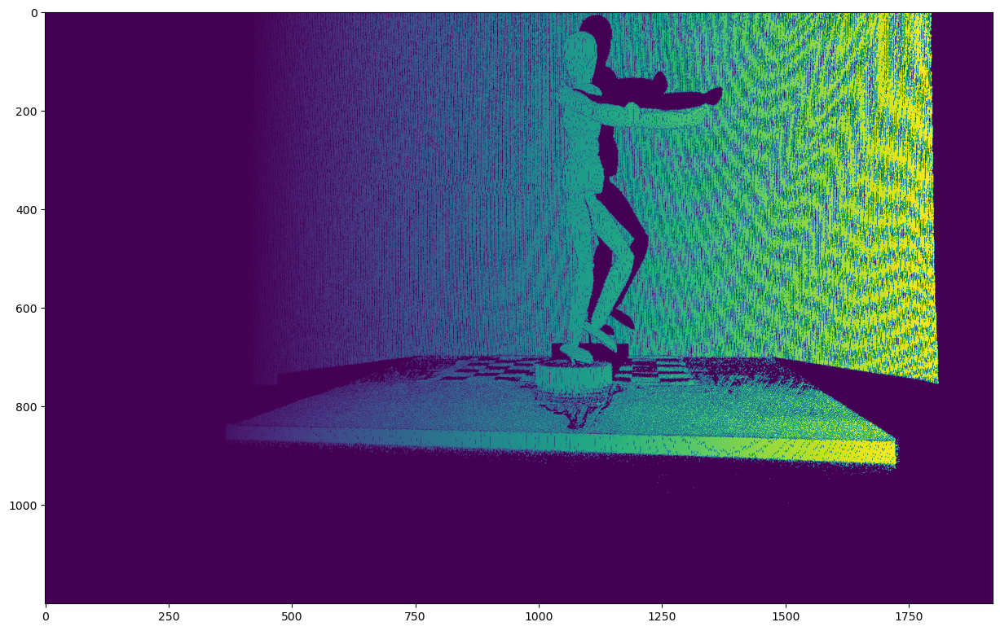

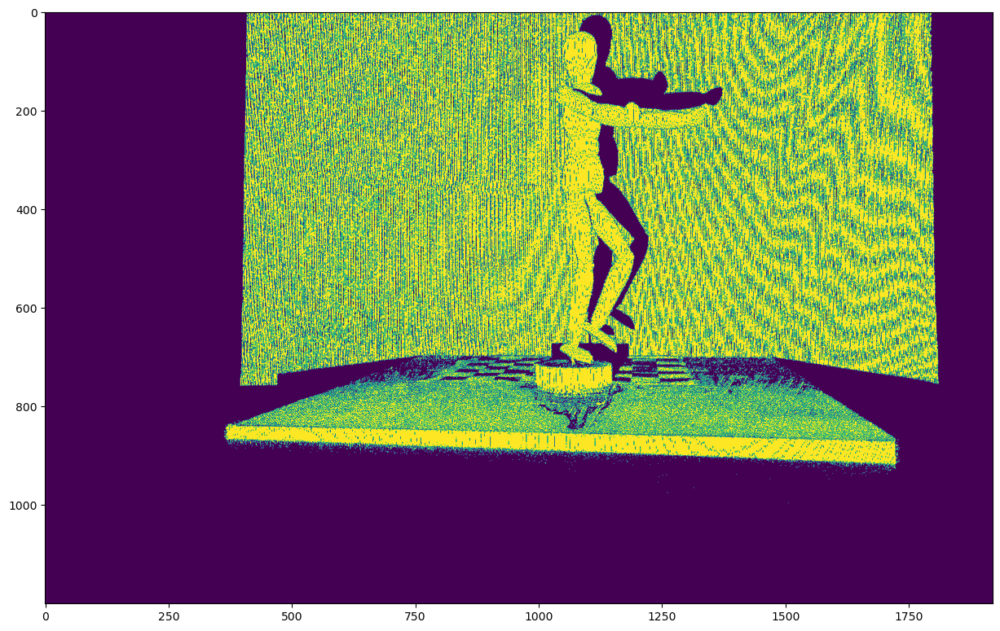

In [33]:
#
# Visualize results for the first scan and experiment to determine a good threshold
#
threshold = 0.01
code,mask = decode('manny\grab_4_u\\frame_C0_',0,threshold)

# display view code and mask as images

plt.rcParams['figure.figsize']=[15,15] #adjust this as needed to get clearly visible figures
plt.imshow(code, plt.show())
plt.imshow(mask, plt.show())

# plt.figure(figsize=(10, 5))

Cam C0 Intrinsic and Extrinsic Parameters:
 Camera : 
 f=1402.2941086224503 
 c=[[959.83703112 583.45486266]] 
 R=[[-0.92568991  0.07930332 -0.36987725]
 [ 0.0476015   0.99442624  0.09407735]
 [ 0.37527629  0.06947974 -0.92430529]] 
 t = [[22.27929377 10.29743094 70.77962746]]
Cam C1 Intrinsic and Extrinsic Parameters:
 Camera : 
 f=1409.0963508535879 
 c=[[963.54993841 599.72053134]] 
 R=[[-0.7486333   0.09233555 -0.65652291]
 [ 0.00551394  0.99108698  0.1331022 ]
 [ 0.66296137  0.09602471 -0.74246985]] 
 t = [[33.89473112  8.8779164  64.3232447 ]]


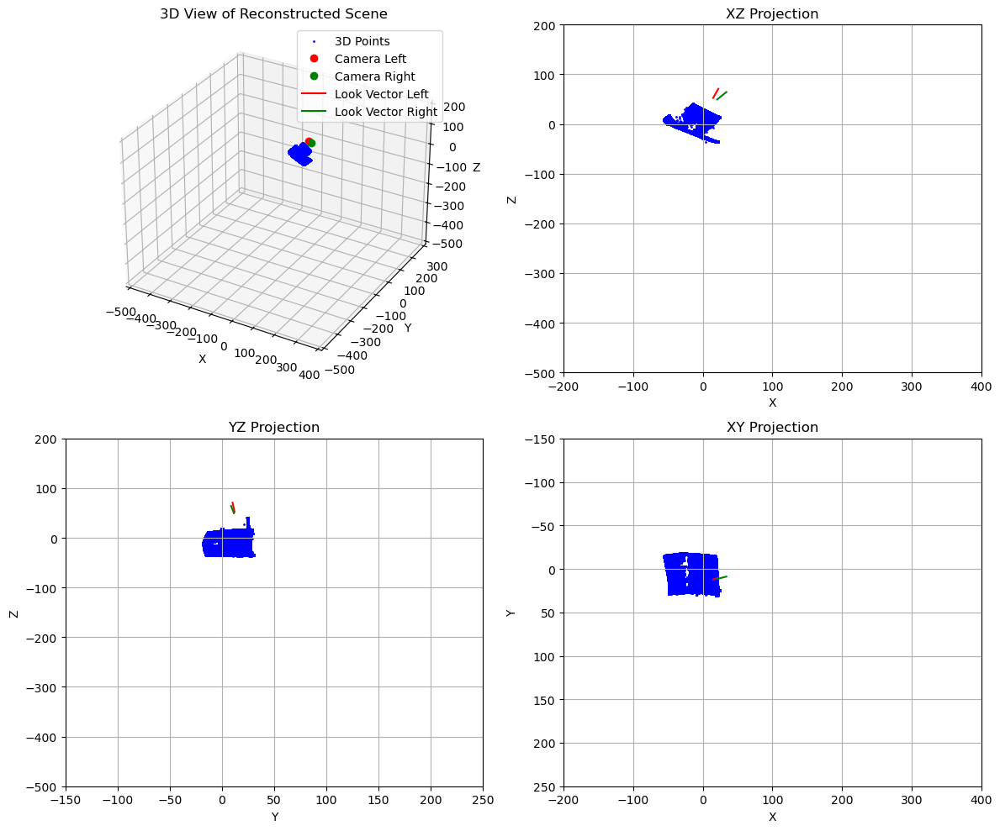

In [34]:
#
# Reconstruct and visualize the results
#
# 

# Image prefixes for the left and right cameras
# C0 is to the right relatively
imprefixC0 = "manny\grab_4_u\\frame_C0_"
# C1 is to the left relatively
imprefixC1 = "manny\grab_4_u\\frame_C1_"
# Default threshold value for now
threshold = 0.01

print("Cam C0 Intrinsic and Extrinsic Parameters:\n", camC0)
print("Cam C1 Intrinsic and Extrinsic Parameters:\n", camC1)

pts2L_manny4,pts2R_manny4,pts3_manny4 = reconstruct(imprefixC0,imprefixC1,threshold,camC0,camC1)

plt.rcParams['figure.figsize']=[15,15] #adjust this as needed to get clearly visible figures
# visutils_2.vis_scene(camC0,camC1,pts3,looklength=20)

# Example usage
# pts3: Triangulated 3D points (3xN numpy array)
# camL and camR: Left and Right camera calibration data
visualize_reconstruction(pts3_manny4, camC0, camC1)



In [35]:
pruned_pts3_manny4, pruned_faces_manny4 = triangle_meshing_pruning(pts2L_manny4, pts3_manny4)

25210


In [36]:
mesh_manny4 = trimesh.Trimesh(vertices=pruned_pts3_manny4.T,faces=pruned_faces_manny4[:,[0,2,1]])
mesh_manny4.show()

# Combining and aligning the meshes
Save the meshes and then combine and align them

Save meshes as .obj files:

In [37]:
# List of trimesh objects
meshes = [mesh_manny0, mesh_manny1, mesh_manny2, mesh_manny3, mesh_manny4]

# Save each trimesh object as an STL file
for i, mesh in enumerate(meshes):
    mesh.export(f"mesh_manny{i}.obj")

In [38]:
import trimesh
import numpy as np

In [39]:
# Load meshes
mesh_paths = ["mesh_manny0.obj", "mesh_manny1.obj", "mesh_manny2.obj", "mesh_manny3.obj", "mesh_manny4.obj"]
meshes = [trimesh.load(path) for path in mesh_paths]

In [40]:
print(type(meshes[0]))

<class 'trimesh.base.Trimesh'>


In [41]:
# Sample points uniformly from mesh surfaces
point_clouds = [mesh.sample(25000) for mesh in meshes]  # Adjust sample size for accuracy


# Algorithms to convert the mesh to point clouds, and then to align with ICP algorithm

### functions to convert mesh to a point cloud, estimate the normals of the point cloud, and perform ICP on the point cloud

In [42]:
import open3d as o3d

# Convert Trimesh point clouds to Open3D PointCloud objects
def trimesh_to_o3d_point_cloud(points):
    o3d_pcd = o3d.geometry.PointCloud()
    o3d_pcd.points = o3d.utility.Vector3dVector(points)
    return o3d_pcd

# Perform alignment
# Estimate normals for source and target point clouds
def estimate_normals(pcd, radius=0.3, max_nn=100):
    pcd.estimate_normals(
        search_param=o3d.geometry.KDTreeSearchParamHybrid(radius=radius, max_nn=max_nn)
    )
    return pcd

# Perform alignment using ICP
def align_with_icp(source_pcd, target_pcd, threshold=75):
    
    source_pcd = estimate_normals(source_pcd)
    target_pcd = estimate_normals(target_pcd)
    
    source_pcd = source_pcd.voxel_down_sample(voxel_size=0.0005)
    target_pcd = target_pcd.voxel_down_sample(voxel_size=0.0005)
    
    o3d.visualization.draw_geometries(
        [source_pcd, target_pcd],
        window_name="Point Cloud Overlap",
        width=800, height=600
    )
    # # Compute FPFH features for both point clouds
    # source_fpfh = o3d.pipelines.registration.compute_fpfh_feature(
    #     source_pcd,
    #     o3d.geometry.KDTreeSearchParamHybrid(radius=0.3, max_nn=100)
    # )
    # target_fpfh = o3d.pipelines.registration.compute_fpfh_feature(
    #     target_pcd,
    #     o3d.geometry.KDTreeSearchParamHybrid(radius=0.3, max_nn=100)
    # )


    # # Perform global alignment using RANSAC
    # result_ransac = o3d.pipelines.registration.registration_ransac_based_on_feature_matching(
    #     source_pcd, target_pcd, source_fpfh, target_fpfh, mutual_filter = False, max_correspondence_distance=1000,
    #     estimation_method=o3d.pipelines.registration.TransformationEstimationPointToPoint(),
    #     ransac_n=1000,
    #     checkers=[
    #         o3d.pipelines.registration.CorrespondenceCheckerBasedOnEdgeLength(0.9),
    #         o3d.pipelines.registration.CorrespondenceCheckerBasedOnDistance(0.8),
    #     ],
    #     criteria=o3d.pipelines.registration.RANSACConvergenceCriteria(2000, 0.999)
    # )

    # # Apply the RANSAC transformation
    # ransac_transformation = result_ransac.transformation
    
    # o3d.visualization.draw_geometries(
    #     [source_pcd.transform(ransac_transformation), target_pcd],
    #     window_name="RANSAC Alignment",
    #     width=800, height=600
    # )

    # Perform ICP registration:
    reg_p2p = o3d.pipelines.registration.registration_icp(
        source=source_pcd,
        target=target_pcd,
        max_correspondence_distance=threshold,
        estimation_method=o3d.pipelines.registration.TransformationEstimationPointToPoint(with_scaling = False),
        criteria=o3d.pipelines.registration.ICPConvergenceCriteria(
            max_iteration=5000,
            relative_rmse = .00000000000000000000000000000001,
            relative_fitness = .00000000000000000000000000000001
            ),
    )
    source_pcd.transform(reg_p2p.transformation)
    transformation = reg_p2p.transformation
    # View the transformation matrix
    print("Transformation Matrix:")
    print(reg_p2p.transformation)

    # View fitness (measure of alignment success, higher is better)
    print("Fitness (alignment measure):", reg_p2p.fitness)

    # View inlier RMSE (Root Mean Square Error of aligned points, lower is better)
    print("Inlier RMSE:", reg_p2p.inlier_rmse)
    
    # instead return the pcd
    return source_pcd

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [62]:
combined_mesh = meshes[0] # start with the first mesh
aligned_meshes = [combined_mesh]  # Reference is the first mesh

# Convert meshes to point clouds, reference is the first mesh
combined_pcd = trimesh_to_o3d_point_cloud(combined_mesh.sample(20000))
# prev_pcd = combined_pcd

for i in range(1, len(meshes)):
    target_mesh = meshes[i]
    target_pcd = trimesh_to_o3d_point_cloud(target_mesh.sample(20000))
    if i != 1:
        angle_radians = np.radians(180)  # Rotation angle in degrees
        rotation_matrix = np.array([
            [np.cos(angle_radians), 0, np.sin(angle_radians)],
            [0, 1, 0],
            [-np.sin(angle_radians), 0, np.cos(angle_radians)]
        ])
        target_pcd.rotate(rotation_matrix, center = (0, 0, 0))
    
    aligned_pcd = align_with_icp(target_pcd, combined_pcd)
    # update the combined pcd
    combined_pcd += aligned_pcd
    combined_pcd = combined_pcd.voxel_down_sample(voxel_size=0.0001)

    
    # Combined pcd visualizataion
    o3d.visualization.draw_geometries(
    [combined_pcd], 
    window_name="Combined Point Cloud Viewer", 
    width=800, height=600, 
    point_show_normal=False )
    # aligned_pcds.append(aligned_pcd) # Update combined point cloud: combined_pcd
    # combined_pcd += aligned_pcd

Transformation Matrix:
[[ 0.52268403  0.09469248 -0.84725129 -0.89584351]
 [-0.03608434  0.99537896  0.08898682 -0.76214408]
 [ 0.85176248 -0.01593948  0.5236856  11.85429475]
 [ 0.          0.          0.          1.        ]]
Fitness (alignment measure): 1.0
Inlier RMSE: 0.5870498024164447
Transformation Matrix:
[[  0.80709971   0.1377913    0.57411115 -12.27463653]
 [ -0.06272069   0.9868931   -0.14868798  -0.50220105]
 [ -0.58707424   0.08399738   0.80516351  20.21745567]
 [  0.           0.           0.           1.        ]]
Fitness (alignment measure): 1.0
Inlier RMSE: 0.568821126349642
Transformation Matrix:
[[  0.5079367    0.03979944  -0.86047447 -20.51803939]
 [ -0.14815926   0.98808159  -0.04175653   1.28956885]
 [  0.8485571    0.14869693   0.50777956   1.83845397]
 [  0.           0.           0.           1.        ]]
Fitness (alignment measure): 1.0
Inlier RMSE: 0.2956249594657215
Transformation Matrix:
[[-0.69032176 -0.02942448 -0.72290391 -6.56335257]
 [-0.06663885  0

In [63]:
# Combined pcd visualizataion
o3d.visualization.draw_geometries(
[combined_pcd], 
window_name="Combined Point Cloud Viewer", 
width=800, height=600, 
point_show_normal=False )

In [64]:
combined_pcd.estimate_normals(search_param=o3d.geometry.KDTreeSearchParamHybrid(radius=0.3, max_nn=100))

# Create a mesh from the point cloud using alpha shapes (creates a triangle mesh)
# You can adjust the alpha value to control the shape and smoothness
alpha = 0.25  # This value controls the mesh quality
mesh = o3d.geometry.TriangleMesh.create_from_point_cloud_alpha_shape(combined_pcd, alpha)

# 5. Optional: Remove small mesh components (noise removal)
# This can help clean up any small, disconnected components that may result from the reconstruction
mesh.remove_unreferenced_vertices()


# Visualize the resulting mesh
o3d.visualization.draw_geometries([mesh], window_name="Point Cloud to Mesh", width=800, height=600)



In [65]:
print(type(mesh))

<class 'open3d.cpu.pybind.geometry.TriangleMesh'>


### Apply texture the triangular mesh

In [66]:
texture_image = o3d.io.read_image("manny\\grab_0_u\\color_C1_01.png")

In [67]:
# Apply the texture to the mesh
mesh.textures = [texture_image]

In [68]:
# Visualize the mesh with texture
o3d.visualization.draw_geometries([mesh], mesh_show_wireframe=True)

In [69]:
o3d.io.write_triangle_mesh("texture_triangle_mesh.obj", mesh)


True

In [70]:
import bpy
bpy.ops.wm.save_as_mainfile(filepath="combined_mesh.blend")

Info: Saved "combined_mesh.blend"


{'FINISHED'}